# Прикладные дифференциальные уравнения
## Занятие 2
*Илья Щуров*

Факультет компьютерных наук, Прикладная математики и информатика, 2021-22 учебный год

[Страница курса](http://math-info.hse.ru/2021-22/Прикладные_дифференциальные_уравнения)

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from plotly import graph_objects as go
%matplotlib inline

Рассмотрим уравнение математического маятника:
$$\ddot x = - \sin x,$$
(для простоты считаем, что коэффициент перед синусом равен единице).

### Задача 1
Найти первый интеграл.
### Задача 2
Нарисовать график первого интеграла и линии уровня.

In [2]:
def H(x, y):
    return y ** 2 / 2 - np.cos(x)

In [3]:
x_range = np.linspace(-7, 7, 500)
y_range = np.linspace(-3, 3, 500)

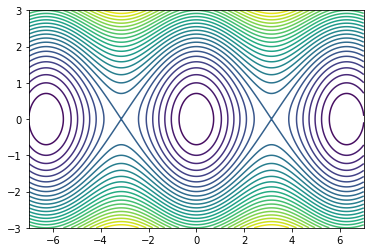

In [4]:
X, Y = np.meshgrid(x_range, y_range)
plt.contour(X, Y, H(X, Y), levels=30)

In [5]:
go.Figure(go.Surface(x=X, y=Y, z=H(X, Y)))

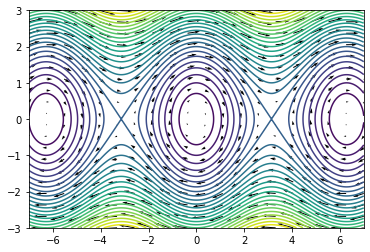

In [6]:
def pendulum(x, y):
    return y, -np.sin(x)

x_range = np.linspace(-7, 7, 500)
y_range = np.linspace(-3, 3, 500)

X, Y = np.meshgrid(x_range, y_range)
plt.contour(X, Y, H(X, Y), levels=30)

x_range_short = np.linspace(-7, 7, 20)
y_range_short = np.linspace(-3, 3, 20)
# взяли точек поменьше, чтобы было не слишком много стрелочек

X_short, Y_short = np.meshgrid(x_range_short, y_range_short)
plt.quiver(X_short, Y_short,
           *pendulum(X_short, Y_short))

In [7]:
from scipy.integrate import odeint, ode

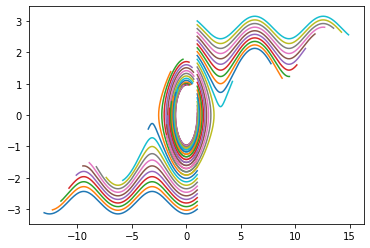

In [8]:
def pendulum(x, y):
    return y, -np.sin(x)

for y0 in np.linspace(-3, 3):
    trajectory = odeint(lambda y, t: np.array(pendulum(y[0], y[1])),
           np.array([1, y0]),
           np.linspace(0, 5, 1000))
    plt.plot(trajectory[:, 0],
             trajectory[:, 1])

In [9]:
solver = ode(lambda t, y: np.array(pendulum(y[0], y[1])))

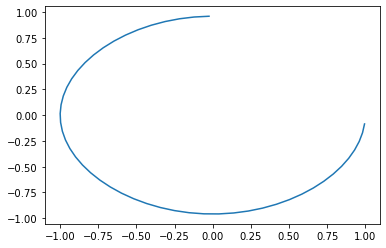

In [17]:
solver.set_initial_value(np.array([1, 0]))
trajectory = []
for t in np.linspace(0, 5)[1:]:
    # [1:] нужен, т.к. https://github.com/scipy/scipy/issues/10909
    
    trajectory.append(solver.integrate(t))
trajectory = np.array(trajectory)
plt.plot(trajectory[:, 0],
         trajectory[:, 1])

In [18]:
def pendulum(x, y):
    return y, -np.sin(x)

def draw_pendulum(x, y, ax1, ax2):
    
    x_range = np.linspace(-7, 7, 500)
    y_range = np.linspace(-3, 3, 500)

    X, Y = np.meshgrid(x_range, y_range)
    ax2.contour(X, Y, H(X, Y), levels=30)

    x_range_short = np.linspace(-7, 7, 20)
    y_range_short = np.linspace(-3, 3, 20)
    X_short, Y_short = np.meshgrid(x_range_short, y_range_short)
    ax2.quiver(X_short, Y_short,
               *pendulum(X_short, Y_short))
    
    ax2.plot([x], [y], 'o', color='C1')
    
    ax1.set_xlim(-2, 2)
    ax1.set_ylim(-2, 2)
    ax1.plot([0, np.sin(x)], [0, -np.cos(x)], '-o', color='C0')
    
    return fig

In [19]:
%pip install celluloid

Note: you may need to restart the kernel to use updated packages.


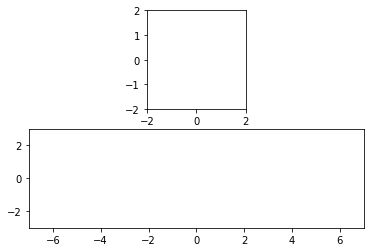

In [20]:
from celluloid import Camera
fig, (ax1, ax2) = plt.subplots(2, 1)

ax1.set_aspect('equal', adjustable='box')
camera = Camera(fig)

solver.set_initial_value(np.array([1, 0]))
trajectory = []
for t in np.linspace(0, 5)[1:]:
    draw_pendulum(*solver.integrate(t), ax1, ax2)
    camera.snap()
animation = camera.animate()

In [21]:
from IPython.display import HTML

In [22]:
HTML(animation.to_jshtml())